# Continuous formation control

In [1]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.animation
from scipy.integrate import solve_ivp
from IPython.display import HTML


VARS_DIM = 2
DTYPE = np.float32
SEED = 42
rng = np.random.default_rng(SEED)

In [2]:
# Square
MAX_TIME = 0.5
SAMPLING_TIME = 0.005
SAFETY_MARGIN = 0.5

NUM_AGENTS = 4
# Edge distance
ED = 4
# Diagonal distance
DD = np.sqrt(2) * ED
# DD = 0

DISTANCES = np.array([
  [0,  ED, DD, ED],
  [ED, 0,  ED, DD],
  [DD, ED, 0,  ED],
  [ED, DD, ED, 0]
], dtype=DTYPE)

In [3]:
# Hexagon
# MAX_TIME = 1.0
# SAMPLING_TIME = 0.005
# SAFETY_MARGIN = 0.5

# NUM_AGENTS = 6
# # Edge distance
# ED = 4
# # Diagonal distance
# DD = 2*ED
# # DD = 0

# DISTANCES = np.array([
#   [0, ED, 0, DD, 0, ED],
#   [ED, 0, ED, 0, DD, 0],
#   [0, ED, 0, ED, 0, DD],
#   [DD, 0, ED, 0, ED, 0],
#   [0, DD, 0, ED, 0, ED],
#   [ED, 0, DD, 0, ED, 0],
# ], dtype=DTYPE)

# # H = np.sqrt(3)*ED
# # DISTANCES = np.array([
#   # [0, ED, 0, DD, H, ED],
#   # [ED, 0, ED, H, DD, 0],
#   # [0, ED, 0, ED, 0, DD],
#   # [DD, H, ED, 0, ED, 0],
#   # [0, DD, 0, ED, 0, ED],
#   # [ED, 0, DD, 0, ED, 0],
# # ], dtype=DTYPE)

In [4]:
def plot_trajectory(horizon, history_x, axis):
    num_agents = history_x.shape[1]
    for i in range(num_agents):
        plt.plot(horizon, history_x[:, i, axis], label=f"agent {i}")
    plt.legend()


def plot_inter_distance_error(history_x, num_agents, distances, horizon):
    err = np.zeros((len(horizon), num_agents, num_agents))
    
    for t in range(len(horizon)):
        xt = history_x[t]

        for i in range(num_agents):
            neighbors = np.nonzero(distances[i])[0]
            for j in neighbors:
                err[t, i, j] = np.abs( np.linalg.norm(xt[i] - xt[j]) - distances[i, j] )

    # At each timestep, the distances of all neighboring agents are plotted
    plt.plot(horizon, err.reshape(len(horizon), -1))
    plt.yscale("log")


def get_animation(history_x, horizon, distances, sampling_time, safety_margin=None, objects=[], tolerance=5e-2):
    num_agents, vars_dim = history_x.shape[1], history_x.shape[2]

    def animate(t):
        plt.clf()

        # Trajectory
        plt.plot(history_x[:t, :, 0], history_x[:t, :, 1], "--", color="tab:gray", alpha=0.5)

        # Connection to neighbors
        for i in range(num_agents):
            for j in range(i+1, num_agents):
                if distances[i, j] > 0:
                    x_i, x_j = history_x[t, i], history_x[t, j]
                    plt.plot(
                        [x_i[0], x_j[0]], [x_i[1], x_j[1]],
                        color = "tab:blue" if np.abs(np.linalg.norm(x_i - x_j, 2) - distances[i, j]) < tolerance else "tab:orange",
                        alpha = 0.5
                    )

        # Agents
        for i in range(num_agents):
            color = matplotlib.colormaps["tab10"](i)
            if safety_margin is not None:
                plt.gca().add_patch( plt.Circle((history_x[t, i, 0], history_x[t, i, 1]), radius=safety_margin, color=color, alpha=0.5) )
            plt.plot(history_x[t, i, 0], history_x[t, i, 1], "o", color=color, label=f"Agent {i}")

        # Objects
        for o in objects:
            plt.plot(o[0], o[1], "x", color="red")

        plt.axis("equal")
        plt.legend()
        plt.title(f"Simulation time = {horizon[t]:.2f} s")

    anim = matplotlib.animation.FuncAnimation(plt.gcf(), animate, frames=(range(0, len(horizon), sampling_time)))
    return anim

Logarithmic barrier function:

\begin{equation}
V_{ij}^\text{ca}(x_i, x_j) = -\log(\Vert x_i - x_j \Vert^2 - d^2)
\end{equation}

\begin{equation}
\begin{split}
        \frac{\partial}{\partial x_i} \left( V_{ij}^\text{ca}(x_i, x_j) + V_{ji}^\text{ca}(x_j, x_i) \right) 
        &= -\frac{1}{\Vert x_i - x_j \Vert^2 - d^2} \cdot 2 (x_i - x_j) -\frac{1}{\Vert x_j - x_i \Vert^2 - d^2} \cdot -2 (x_j - x_i) \\
        &= -\frac{1}{\Vert x_i - x_j \Vert^2 - d^2} \cdot 2 (x_i - x_j) -\frac{1}{\Vert x_i - x_j \Vert^2 - d^2} \cdot 2 (x_i - x_j) \\
        &= -\frac{4}{\Vert x_i - x_j \Vert^2 - d^2} \cdot (x_i - x_j) 
\end{split}
\end{equation}

In [5]:
def _barrier_function_dxi(x_i, x_j, safety_distance):
    return - ( 4/((np.linalg.norm(x_i - x_j, 2)**2 - safety_distance**2)) ) * (x_i - x_j)


def build_formation_vector_field(distances, num_agents, vars_dim, collision_avoidance, object_avoidance, safety_distance, objects):
    """
        Defines the potential function
    """
    def formation_vect_field(t, xt):
        xt = xt.reshape(num_agents, vars_dim)
        d_xt = np.zeros_like(xt)

        for i in range(num_agents):
            neighbors = np.nonzero(distances[i])[0]
            
            d_xt[i] = -sum( (np.linalg.norm(xt[i] - xt[j])**2 - distances[i, j]**2) * (xt[i] - xt[j]) for j in neighbors )
            if collision_avoidance:
                d_xt[i] -= sum( _barrier_function_dxi(xt[i], xt[j], safety_distance) for j in neighbors )
            if object_avoidance:
                d_xt[i] -= sum( _barrier_function_dxi(xt[i], o, safety_distance) for o in objects )

        return d_xt.flatten()

    return formation_vect_field

In [6]:
def formation_control(x0, distances, num_agents, vars_dim, max_time, sampling_time, collision_avoidance, object_avoidance, safety_distance=0, objects=[]):
    horizon = np.arange(0, max_time+sampling_time, sampling_time)
    
    res = solve_ivp( # Solves an initial value problem (i.e., gradient flow)
        fun = build_formation_vector_field(distances, num_agents, vars_dim, collision_avoidance, object_avoidance, safety_distance, objects),
        t_span = (0, max_time+sampling_time),
        y0 = x0.flatten(),
        t_eval = horizon,
        method = "RK45"
    )
    history_x = res.y.T.reshape(-1, num_agents, vars_dim)

    return history_x, horizon

In [7]:
x0 = rng.uniform(low=-5, high=5, size=(NUM_AGENTS, VARS_DIM))

## Without collision avoidance

In [8]:
history_x, horizon = formation_control(
    x0 = x0.copy(),
    distances = DISTANCES.copy(),
    num_agents = NUM_AGENTS, 
    vars_dim = VARS_DIM, 
    max_time = MAX_TIME, 
    sampling_time = SAMPLING_TIME, 
    collision_avoidance = False,
    object_avoidance = False
)

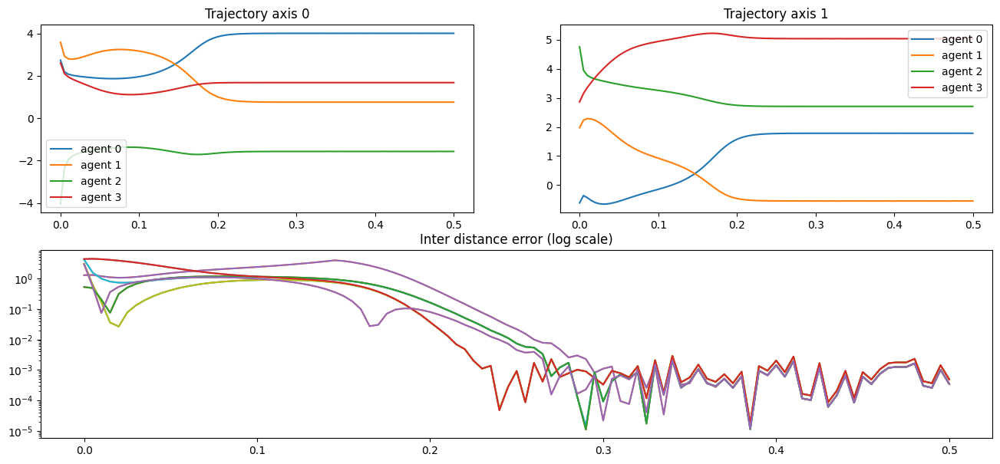

In [9]:
%matplotlib inline

plt.figure(figsize=(16, 7))
plt.subplot(2, 2, 1)
plot_trajectory(horizon, history_x, 0)
plt.title("Trajectory axis 0")

plt.subplot(2, 2, 2)
plot_trajectory(horizon, history_x, 1)
plt.title("Trajectory axis 1")

plt.subplot(2, 2, (3, 4))
plot_inter_distance_error(history_x, NUM_AGENTS, DISTANCES, horizon)
plt.title("Inter distance error (log scale)")

plt.show()

In [10]:
%matplotlib notebook
anim = get_animation(history_x, horizon, DISTANCES, sampling_time=1)
HTML(anim.to_jshtml())

<IPython.core.display.Javascript object>

## With agents collision avoidance

In [11]:
history_x, horizon = formation_control(
    x0 = x0.copy(),
    distances = DISTANCES.copy(),
    num_agents = NUM_AGENTS, 
    vars_dim = VARS_DIM, 
    max_time = MAX_TIME, 
    sampling_time = SAMPLING_TIME, 
    collision_avoidance = True,
    object_avoidance = False,
    safety_distance = SAFETY_MARGIN
)

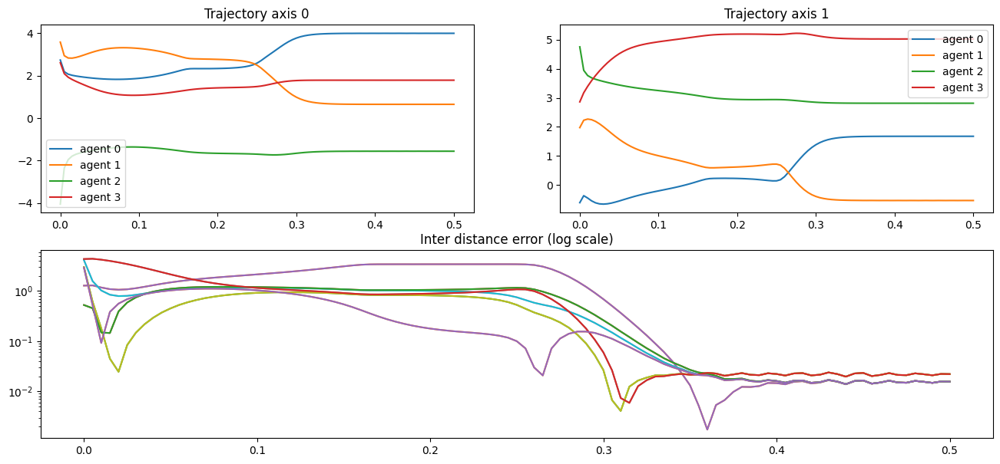

In [12]:
%matplotlib inline

plt.figure(figsize=(16, 7))
plt.subplot(2, 2, 1)
plot_trajectory(horizon, history_x, 0)
plt.title("Trajectory axis 0")

plt.subplot(2, 2, 2)
plot_trajectory(horizon, history_x, 1)
plt.title("Trajectory axis 1")

plt.subplot(2, 2, (3, 4))
plot_inter_distance_error(history_x, NUM_AGENTS, DISTANCES, horizon)
plt.title("Inter distance error (log scale)")

plt.show()

In [13]:
%matplotlib notebook
anim = get_animation(history_x, horizon, DISTANCES, safety_margin=SAFETY_MARGIN, sampling_time=1)
HTML(anim.to_jshtml())

<IPython.core.display.Javascript object>

## With object avoidance

In [14]:
MAX_TIME = 1.5
SAMPLING_TIME = 0.001
SAFETY_MARGIN = 0.5

NUM_AGENTS = 4
ED = 4
DD = np.sqrt(2) * ED

DISTANCES = np.array([
  [0,  ED, DD, ED],
  [ED, 0,  ED, DD],
  [DD, ED, 0,  ED],
  [ED, DD, ED, 0]
], dtype=DTYPE)

In [15]:
x0 = np.array([
    [4, -4],
    [-4, -4],
    [4, 4],
    [-4, 4],
])

objects = np.array([
    *[[i, 2] for i in np.arange(-4, -3.5, 0.2)],
    *[[-2, i] for i in np.arange(3, 1, -0.2)],
    [-3, 0]
])

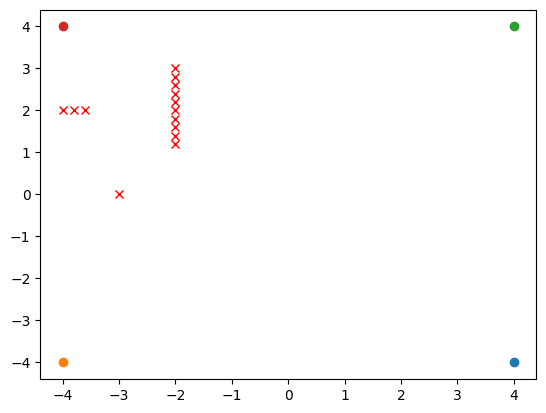

In [16]:
%matplotlib inline
for i in range(NUM_AGENTS):
    plt.plot(x0[i, 0], x0[i, 1], "o")

for o in objects:
    plt.plot(o[0], o[1], "x", color="red")

In [17]:
history_x, horizon = formation_control(
    x0 = x0.copy(),
    distances = DISTANCES.copy(),
    num_agents = NUM_AGENTS, 
    vars_dim = VARS_DIM, 
    max_time = MAX_TIME, 
    sampling_time = SAMPLING_TIME, 
    collision_avoidance = True,
    object_avoidance = True,
    safety_distance = SAFETY_MARGIN,
    objects = objects
)

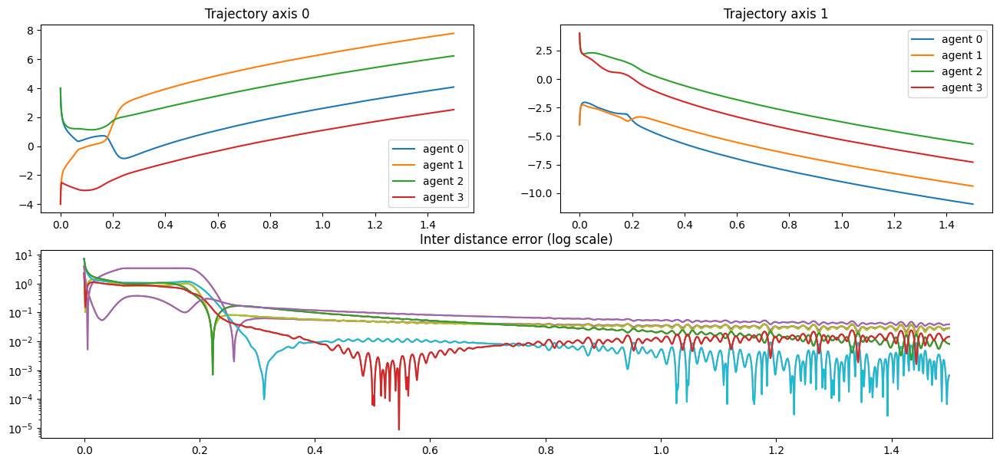

In [18]:
%matplotlib inline

plt.figure(figsize=(16, 7))
plt.subplot(2, 2, 1)
plot_trajectory(horizon, history_x, 0)
plt.title("Trajectory axis 0")

plt.subplot(2, 2, 2)
plot_trajectory(horizon, history_x, 1)
plt.title("Trajectory axis 1")

plt.subplot(2, 2, (3, 4))
plot_inter_distance_error(history_x, NUM_AGENTS, DISTANCES, horizon)
plt.title("Inter distance error (log scale)")

plt.show()

In [19]:
%matplotlib notebook
anim = get_animation(history_x, horizon, DISTANCES, safety_margin=SAFETY_MARGIN, objects=objects, sampling_time=5)
HTML(anim.to_jshtml())

<IPython.core.display.Javascript object>